# Dynap-SE2 Developer Docs

## Introduction

Dynap-SE2 API support provides an abstract Dynap-SE2 machine that operates in the same parameter space as Dynap-SE2 processors. 
More, it provides all the tools required to convert a simulation setting to an hardware configuration and a hardware configuration to a simulation setting.

It's possible to go from simulation to deployment:

* Define a rockpool network 
* Map this network to a hardware specification
* Quantize the parameters
* Obtain a samna configuration
* Connect and configure a Dynap-SE2 chip 
* Run a real-time, hardware simulation

*Simulation -> Device (pseudo-code)*

```python
    # Define
    net = Sequential(LinearJax((Nin, Nrec)), DynapSim((Nrec, Nrec)))

    # Map
    spec = mapper(net.as_graph())
    spec.update(autoencoder_quantization(**spec))
    config = config_from_specification(**spec)

    # Connect 
    se2_devices = find_dynapse_boards()
    se2 = DynapseSamna(se2_devices[0], **config)
    out, state, rec = se2(raster, record=True)
```

It's also possible to go from hardware configuration to simulation:

*Device -> Simulation (pseudo-code)*

```python
    net = dynapsim_net_from_config(**config)
    out, state, rec = net(raster, record=True)
```

## Package Structure

In [13]:
from IPython.display import Image
Image("uml/se2_api.png", width="1024")

## `devices.dynapse.simulation`

In [12]:
Image("uml/simulation.png", width="1024")


Simulation package encapsulates the modules and utilities required to execute a computational simulation based on VLSI dynamics. The class `DynapSim` is a `jax`-backend neuron model that solves analog VLSI circuit equations to provide a simulated machine. It uses forward Euler updates to predict the time-dependent dynamics and solves the characteristic circuit transfer functions in time.

`DynapSim` inherits from `JaxModule`; therefore, its compatible to work with the other jax-backend rockpool modules in combination.


```python
Sequential(LinearJax((n_in,n_rec1)), LIFJax((n_rec1,n_rec1)), LinearJax((n_rec1,n_rec2)), DynapSim((n_rec2,n_rec2)))
```


To assure operation flexibility, all the current parameters that we can change via bias generators on chip are object constructor parameters: `If_nmda`, `Igain_ahp`, `Igain_mem`, `Igain_syn`, `Ipulse_ahp`, `Ipulse`, `Iref`, `Ispkthr`, `Itau_ahp`, `Itau_mem`, `Itau_syn`, `Iw_ahp`. Also, even though layout parameters are fixed on production, in simulator we have the flexibility to change. Therefore all layout depended silicon parameters: `C_ahp`, `C_syn`, `C_pulse_ahp`, `C_pulse`, `C_ref`, `C_mem`, `Io`, `kappa_n`, `kappa_p`, `Ut`, `Vth` are also defined as are object constructor parameters. The statets `iahp`,  `iampa`,  `igaba`,  `imem`,  `inmda`,  `ishunt`,  `spikes`,  `timer_ref`,  `vmem` are only stored as an attribute but cannot be changed externally. Only a state evolution can change their values.

Weight handling in Dynap-SE2 has 2 sides: core-wide base currents and connection specific bit-masks. For the sake of a better optimization support, the simulator is free from the hardware constraints applying on the synapses. Weight matrices are regular 32-bit floating point arrays which subject to post-training quantization. `Iscale` sets a reference point for the base weight currents. However, it's **not** absolutely necessary for post-training quantization. In later releases, it can be replaced by a search algorithm which automatically finds a scaling reference which projects the synapses best to the chip.

### Utilities

`simulation` package stores the mismatch prototype definitions. `frozen_mismatch_prototype()` and `dynamic_mismatch_prototype()` are the convenience methods to analyse any `rockpool` `jax` network and return a parameter subtree on which it makese sense to apply mismatch.

The package also provides surrogate gradient function definitions which are escpecially important applying a gradient-based optimization. Currently, only one definition is provided but there is always room for implementing more if required.

## `devices.dynapse.mapping`

In [14]:
Image("uml/mapping.png", width="1024")

Mapping package implements the functionality to obtain a Dynap-SE2 HDK hardware specification from an SNN. The main function `mapper()` projects a computational graph onto Dynap-SE2 architecture. Fundamentally, it clusters parameters in groups and specifies hardware posititons for neurons. `mapper()` does not require specifically a `DynapSim` network to project to a hardware specification because the conversion across different layers are possible. 

In rockpool, network modules overrides the abstract `as_graph()` method to be able to extract a simpler computational graph from a complex module. Computational graphs are intermediate representations which holds only the computationally important parameters. When applicable, they make it possible to convert the layers between each others while keeping the computational properties the same. 

`DynapseNeurons` serves as the intermediate representation to extract a computational graph from a `DynapSim` layer. It holds only the current values that can be **configured** on chip. So, neither the state currents nor the layout parameters stored. Currently, only from a `LIFNeuronWithSynsRealValue` to `DynapseNeurons` conversion is possible and the other way around is not implemented. This makes it possible to extract a computational graph from a multi-layer LIF (jax or torch) network and to convert it to a `DynapSim` computational graph. That is usually the first step of the mapping process.

`mapper()` uses the `lifnet_to_dynapsim()` conversion prior to any step in hardware specification to get a standard representation. `NPGrid` and `DFAPlacement` are the utility classes that helps the `lifnet_to_dynapsim()` to process a multi-layer network definition to obtain a computationally equivalent single layer definition. `NPGrid` builds virtual grids on a weight matrix and allocates logical regions for intermediate layers on the big recurrent weight matrix that the merged structure is to be projected. `DFAPlacement` defines a state machine that processes the multilayer structure and takes different actions regarding the different layers encountered. These are completely non user interfaced parts of the Dynap-SE2 API and implements the fundamentals of the hardware specification.

Succesfully pre-processing the SNNs, `mapper` reduces every SNN down to 3 connected graph modules. One `DynapseNeurons` object holding parameter current values of the hardware neurons. One `LinearWeights` object holding the input weights from the external connections to the hardware neurons, one `LinearWeights` object holding the recurrent weights between hardware neurons. A `DynapseGraphHolder` structure holds those graph modules and applies design rule checks to make sure that the specification is deployable so far.

In short, `mapper()` gets any SNN graph, process the layers, returns a hardware specification if nothing is wrong, and raises an error if it's impossible to deploy the given graph to a Dynap-SE2 HDK. The `mapping` package implements the functionality to process the SNN layers and obtain a hardware specification. However, it does not guarantee that the network is deployable. The later stages like quantization and configuration object generation can still determine some design rule violations that `mapper()` is unable to detect.

## quantization

In [16]:
Image("uml/quantization.png", width="1024")

## `devices.dynapse.parameters`

In [15]:
Image("uml/parameters.png", width="1024")

Parameters package collects the high-level parameters <-> currents <-> configuration (DAC : coarse, fine values) conversion utilities. The high level parameters mean the most abstract human-comprehensible and less hardware-configurable parameters like time constants and gain ratios. These parameters are the ones that logically make sense but cannot be directly applied on circuits. They always depends on some current values to indirectly influence the behaviour. For example a relation between a time constant ($\tau$) and the leakage current ${I_{\tau}}$ can be represented as

$$
    \tau = \dfrac{C_{syn}U_{T}}{\kappa I_{\tau}}
$$

The high_level parameters subpackage is responsible for reflecting the high-level parameters to their relative low-level conjugates. The low level sub-package stores nearly the same parameter space with the `DynapSim` layer. However, different from it, `DynapSimCore` specifies the `Isyn` currents in more detail : `I_ampa`, `I_gaba`, `I_nmda`, `I_shunt`. The reason that we cannot express them in `DynapSim` layer is that for the simulation, it's important to the flexibility to represent negative synaptic currents. However in hardware, negative currents are not supported. Instead, there are inhibitory synapses that can reproduce the negative connection effect. 

`DynapSimCore` can process a `samna` hardware configuration object and read the current values that the bias generator setting will produce. It can also find the digital to analog converter setting (`samna` hardware configuration) that will produce the currents indicated. So it support both way of operation and stand in the middle as an intermediate collector. `biasgen` subpackage utilities makes it possible to convert from the hardware configuration to current specification and vice versa.

`DynapSim` is on the other hand just uses those currents to compute the dynamics.

`DynapseNeurons`'s job definition looks similar to an encapsulated `DynapSimCore` package `DynapSimCurrents` but it's fundamentally different. They are both indermediate level representations standing at different levels. `DynapseNeurons` is a graph package granting the base for converting the rockpool jax layers between each others. On the other hand, `DynapSimCurrents` provides a data-class closer to the hardware description having clear specification for `Isyn` currents : `I_ampa`, `I_gaba`, `I_nmda`, `I_shunt`.


## dynapsim_net

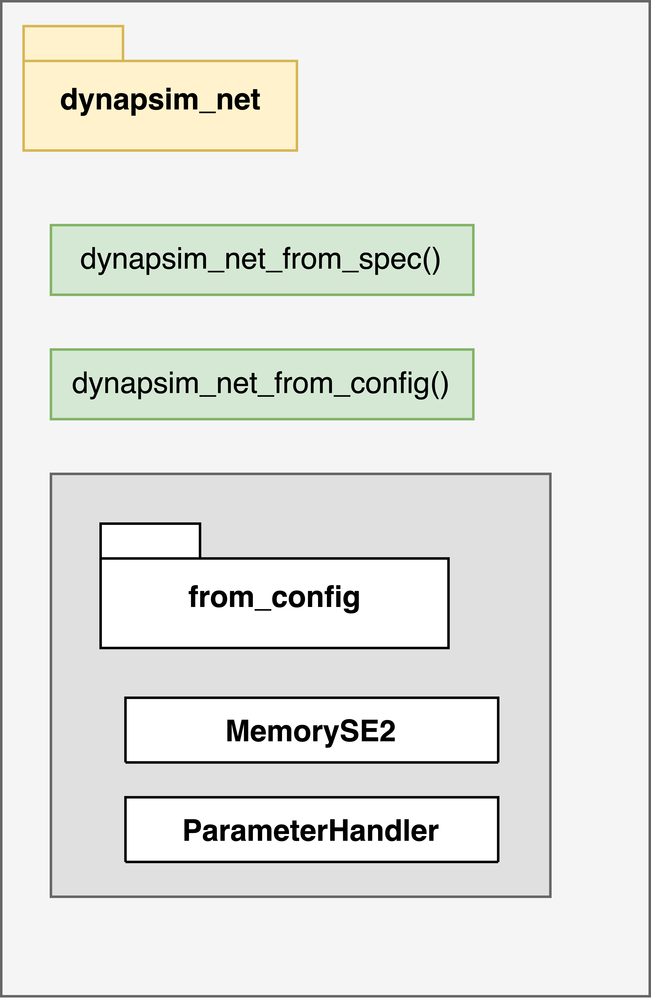

In [9]:
Image("uml/dynapsim_net.png", width=480)

## hardware

In [17]:
Image("uml/hardware.png", width="1024")

## lookup

## samna_aliases